# Stage 1 - Image Captioning by BLIP-2

## Environment preparation

In [ ]:
!pip install --upgrade git+https://github.com/huggingface/transformers.git

  Cloning https://github.com/huggingface/transformers.git to /tmp/pip-req-build-8mvcqt02
  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/transformers.git /tmp/pip-req-build-8mvcqt02
  Resolved https://github.com/huggingface/transformers.git to commit add53e25ffa3d1750a944086d2fbb016aee35406
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 50.2 MB/s eta 0:00:00
  Created wheel for transformers: filename=transformers-4.48.0.dev0-py3-none-any.whl size=10213955 sha256=9e83d79e1173dea0f3047f3c7019968f3a59996eb09f6b04657c8ae051c53ec5
  Stored in directory: /tmp/pip-ephem-wheel-cache-reyifzjb/wheels/e7/9c/5b/e1a9c8007c343041e61cc484433d512ea9274272e3fcbe7c16
Successfully built transformers
  Attempting uninstall: tokenizers
    Found existing installation: tokenizers 0.20.3
    Uninstalling tokenizers-0.20.3:
      S

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/cvpdl_hw3.zip -d /content/

Archive:  /content/drive/MyDrive/cvpdl_hw3.zip
   creating: /content/images/
  inflating: /content/images/construction-site-build-construction-work-159306.jpeg  
  inflating: /content/images/construction-site-build-construction-work-159375.jpeg  
  inflating: /content/images/gardener-worker-gardening-machinery-162564.jpeg  
  inflating: /content/images/harvest-grain-combine-arable-farming-163752.jpeg  
  inflating: /content/images/pexels-photo-10039988.jpeg  
  inflating: /content/images/pexels-photo-10040003.jpeg  
  inflating: /content/images/pexels-photo-10084716.jpeg  
  inflating: /content/images/pexels-photo-10088317.jpeg  
  inflating: /content/images/pexels-photo-10130754.jpeg  
  inflating: /content/images/pexels-photo-1018565.jpeg  
  inflating: /content/images/pexels-photo-1018568.jpeg  
  inflating: /content/images/pexels-photo-10202856.jpeg  
  inflating: /content/images/pexels-photo-10316634.jpeg  
  inflating: /content/images/pexels-photo-10341105.jpeg  
  inflating: /co

## Run

### Load model

In [ ]:
from transformers import AutoProcessor, Blip2ForConditionalGeneration
import torch

processor = AutoProcessor.from_pretrained("Salesforce/blip2-opt2.7b")
# by default `from_pretrained` loads the weights in float32
# we load in float16 instead to save memory
model = Blip2ForConditionalGeneration.from_pretrained("Salesforce/blip2-opt2.7b", torch_dtype=torch.float16)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


processor_config.json:   0%|          | 0.00/68.0 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/432 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/21.0k [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.42M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/23.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/2.54k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/2.22k [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/128k [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/9.96G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/5.81G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/168 [00:00<?, ?B/s]

In [ ]:
device = 'cuda'
model.to(device)

Blip2ForConditionalGeneration(
  (vision_model): Blip2VisionModel(
    (embeddings): Blip2VisionEmbeddings(
      (patch_embedding): Conv2d(3, 1408, kernel_size=(14, 14), stride=(14, 14))
    )
    (encoder): Blip2Encoder(
      (layers): ModuleList(
        (0-38): 39 x Blip2EncoderLayer(
          (self_attn): Blip2Attention(
            (dropout): Dropout(p=0.0, inplace=False)
            (qkv): Linear(in_features=1408, out_features=4224, bias=True)
            (projection): Linear(in_features=1408, out_features=1408, bias=True)
          )
          (layer_norm1): LayerNorm((1408,), eps=1e-06, elementwise_affine=True)
          (mlp): Blip2MLP(
            (activation_fn): GELUActivation()
            (fc1): Linear(in_features=1408, out_features=6144, bias=True)
            (fc2): Linear(in_features=6144, out_features=1408, bias=True)
          )
          (layer_norm2): LayerNorm((1408,), eps=1e-06, elementwise_affine=True)
        )
      )
    )
    (post_layernorm): LayerNorm((

In [ ]:
import json

with open('/content/label.json') as f:
  images = json.load(fp = f)
  img_list = [img["image"] for img in images]
  label_list = [img["labels"] for img in images]

### Test sample

In [ ]:
from PIL import Image
image = Image.open("/content/images/" + img_list[12])
print(image.size)

(4256, 2832)


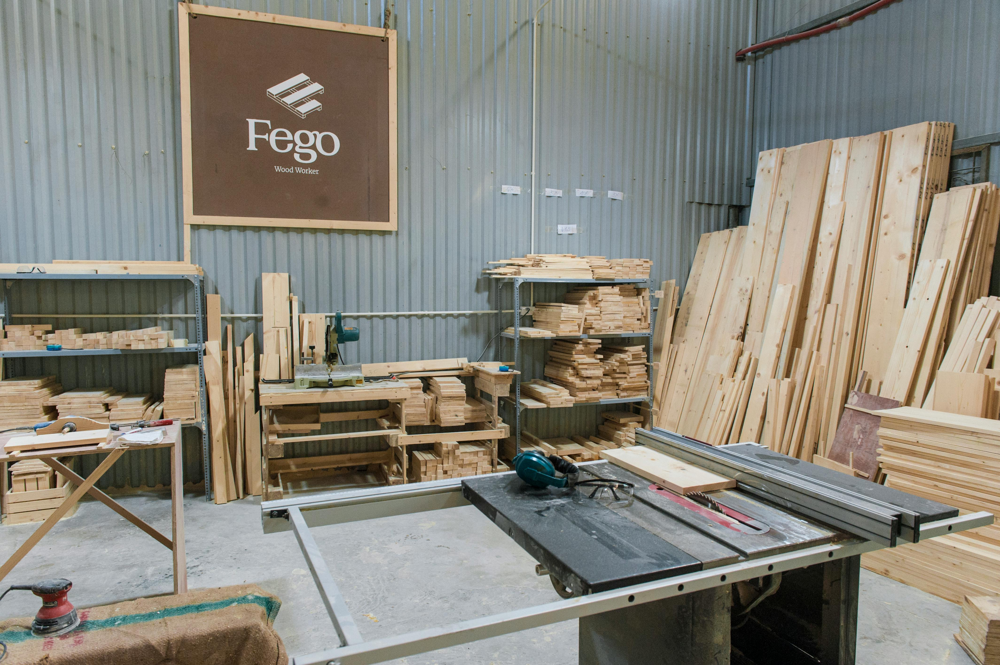

In [ ]:
display(image)

In [ ]:
suffix = "height: 512, weight: 512"
hd_suffix = ", HD quality, highly detailed"

In [ ]:
inputs = processor(image, return_tensors="pt").to(device, torch.float16)

generated_ids = model.generate(**inputs)
generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0].strip()
print(generated_text)

a workshop with many wooden pieces and tools


## Run all image captioning

In [ ]:
import tqdm

for i in tqdm.tqdm(range(len(img_list))):
  image = Image.open("/content/images/" + img_list[i])
  inputs = processor(image, return_tensors="pt").to(device, torch.float16)

  generated_ids = model.generate(**inputs)
  generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0].strip()
  prompt_w_label = generated_text + " " + (", ".join(map(str, label_list[i])) + ", ") + suffix
  prompt_w_suffix = prompt_w_label + hd_suffix

  images[i]["generated_text"] = generated_text
  images[i]["prompt_w_label"] = prompt_w_label
  images[i]["prompt_w_suffix"] = prompt_w_suffix


with open("updated_label.json", "w") as file:
    json.dump(images, file, indent=4)


100%|██████████| 2160/2160 [42:07<00:00,  1.17s/it]


# Stage 2 - Layouy2img guidance stable diffusion by GLIGEN

## Load Upadated label

In [ ]:
import json
with open('/content/updated_label.json') as f:
  up_images = json.load(fp = f)
  up_img_list = [img["image"] for img in up_images]
  up_label_list = [img["labels"] for img in up_images]

## Load GLIGEN model

In [ ]:
from diffusers import StableDiffusionGLIGENTextImagePipeline
import torch

pipe = StableDiffusionGLIGENTextImagePipeline.from_pretrained("anhnct/Gligen_Text_Image", torch_dtype=torch.float16)
pipe = pipe.to("cuda")



/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/8 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--anhnct--Gligen_Text_Image/snapshots/c4ea3545c59a161096adc00aa14fa163c687614a/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--anhnct--Gligen_Text_Image/snapshots/c4ea3545c59a161096adc00aa14fa163c687614a/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--anhnct--Gligen_Text_Image/snapshots/c4ea3545c59a161096adc00aa14fa163c687614a/image_project: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--anhnct--Gligen_Text_Image/snapshots/c4ea3545c59a161096adc00aa14fa163c687614a/image_project.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--anhnct--Gligen_Te

### Test sample(Useless)

In [ ]:
from diffusers.utils import load_image
from PIL import Image
test_image = Image.open("/content/images/" + up_img_list[101])
test_image = test_image.resize((512,512))
print(test_image.size)
gligen_image = load_image(test_image)
# gligen_image.resize((512,512))
gligen_placeholder = gligen_image

(512, 512)


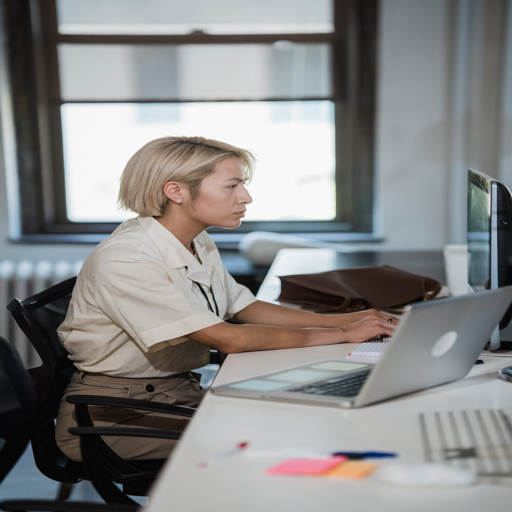

In [ ]:
display(gligen_image)

In [ ]:
suffix = ", height: 512, weight: 512"
hd_suffix = ", HD quality, highly detailed"

In [ ]:
prompt = up_images[101]["generated_text"]
pt = up_images[101]["prompt_w_label"]
boxes = up_images[101]["bboxes"]
phrases = up_images[101]["labels"]
height = 512
width = 512

In [ ]:
boxes = [[coor/512 for coor in bbox] for bbox in boxes]

In [ ]:
image2 = pipe(prompt = prompt,
            gligen_phrases = phrases,
            # gligen_images = gligen_images + [gligen_placeholder],
            # gligen_images=[gligen_placeholder]+[gligen_image for i in range(len(phrases)-1)],
            # input_phrases_mask=[1]+[0 for i in range(len(phrases)-1)],  # Set 0 for the placeholder token
            # input_images_mask=[0]+[1 for i in range(len(phrases)-1)],  # Set 0 for the placeholder image
            gligen_boxes = boxes,
            output_type = "pil",
            num_inference_steps=30,
            height=height,
            width=width).images
# display(image)
image4 = pipe(prompt = pt,
            gligen_phrases = phrases,
            # gligen_images = gligen_images + [gligen_placeholder],
            # gligen_images=[gligen_placeholder]+[gligen_image for i in range(len(phrases)-1)],
            # input_phrases_mask=[1]+[0 for i in range(len(phrases)-1)],  # Set 0 for the placeholder token
            # input_images_mask=[0]+[1 for i in range(len(phrases)-1)],  # Set 0 for the placeholder image
            gligen_boxes = boxes,
            output_type = "pil",
            num_inference_steps=30,
            height=height,
            width=width).images
# display(image)

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

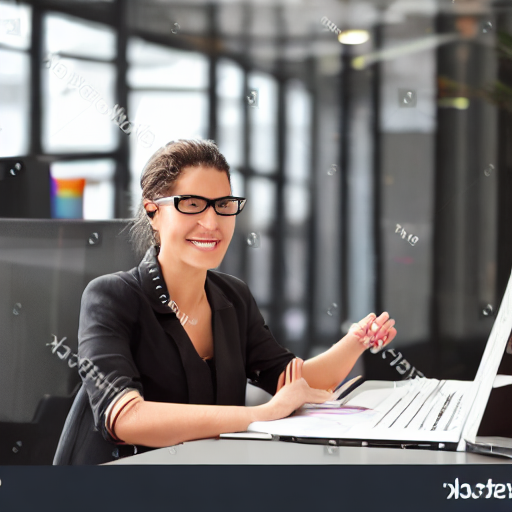

In [ ]:
display(image2[0])

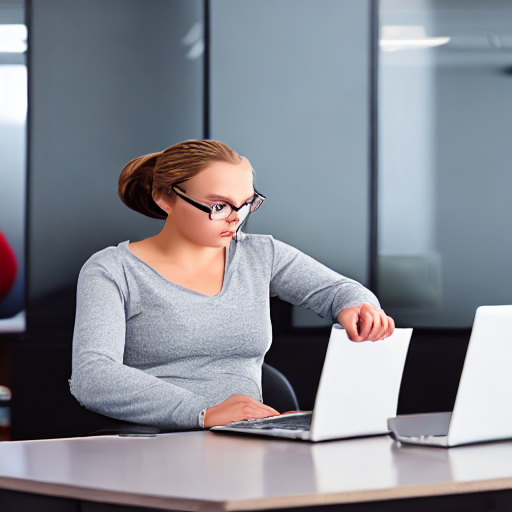

In [ ]:
display(image4[0])

In [ ]:
# image = pipe(prompt = prompt,
#             gligen_phrases = phrases,
#             gligen_images = [gligen_placeholder],
#             # gligen_images=[gligen_placeholder]+[gligen_image for i in range(len(phrases)-1)],
#             # input_phrases_mask=[1]+[0 for i in range(len(phrases)-1)],  # Set 0 for the placeholder token
#             # input_images_mask=[0]+[1 for i in range(len(phrases)-1)],  # Set 0 for the placeholder image
#             gligen_boxes = boxes,
#             output_type = "pil",
#             num_inference_steps=50,
#             height=height,
#             width=width).images
# # display(image)

  0%|          | 0/50 [00:00<?, ?it/s]

## Run all layout-to-image

In [ ]:
!mkdir output

In [ ]:
import json
import tqdm
with open('/content/flan_xl_updated_label.json') as f:
  up_images = json.load(fp = f)
  up_img_list = [img["image"] for img in up_images]
  up_label_list = [img["labels"] for img in up_images]

for i in tqdm.tqdm(range(len(up_img_list))):
    # filter too long prompt for CLIP
    if len(up_images[i]["prompt_w_label"].split(" ")) > 40:
        prompt = up_images[i]["generated_text"]
    else:
        prompt = up_images[i]["prompt_w_label"]
    boxes = up_images[i]["bboxes"]
    phrases = up_images[i]["labels"]
    # filter too many objects for GLIGEN
    if len(boxes) > 25:
        boxes = boxes[:25]
        phrases = phrases[:25]
    height = 512
    width = 512

    # resize bbox for GLIGEN
    boxes = [[coor/512 for coor in bbox] for bbox in boxes]
    image3 = pipe(
              prompt = prompt,
              gligen_phrases = phrases,
              gligen_boxes = boxes,
              output_type = "pil",
              num_inference_steps=30,
              height=height,
              width=width
            ).images[0]

    image3.save("/content/output/" + "output_" + f"{up_img_list[i]}")




  0%|          | 0/2160 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 1/2160 [00:13<8:20:50, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 2/2160 [00:28<8:29:38, 14.17s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 3/2160 [00:42<8:33:30, 14.28s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 4/2160 [00:56<8:27:44, 14.13s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 5/2160 [01:10<8:24:33, 14.05s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 6/2160 [01:24<8:20:09, 13.93s/it]Token indices sequence length is longer than the specified maximum sequence length for this model (91 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', person, height : 5 1 2, weight : 5 1 2']


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 7/2160 [01:38<8:20:26, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 8/2160 [01:52<8:21:10, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 9/2160 [02:06<8:23:14, 14.04s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 10/2160 [02:20<8:23:33, 14.05s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 11/2160 [02:34<8:23:52, 14.07s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 12/2160 [02:48<8:22:32, 14.04s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 13/2160 [03:02<8:20:25, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 14/2160 [03:16<8:19:11, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 15/2160 [03:30<8:19:09, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 16/2160 [03:44<8:19:21, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 17/2160 [03:58<8:19:21, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 18/2160 [04:12<8:18:11, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 19/2160 [04:26<8:17:41, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 20/2160 [04:40<8:17:32, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 21/2160 [04:53<8:15:56, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 22/2160 [05:07<8:15:46, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 23/2160 [05:21<8:15:38, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 24/2160 [05:35<8:14:14, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 25/2160 [05:49<8:14:01, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|          | 26/2160 [06:03<8:13:59, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|▏         | 27/2160 [06:17<8:16:37, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|▏         | 28/2160 [06:31<8:16:07, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|▏         | 29/2160 [06:45<8:17:55, 14.02s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|▏         | 30/2160 [06:59<8:18:48, 14.05s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|▏         | 31/2160 [07:13<8:17:21, 14.02s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  1%|▏         | 32/2160 [07:27<8:16:32, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 33/2160 [07:41<8:15:29, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 34/2160 [07:55<8:14:03, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 35/2160 [08:09<8:13:33, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 36/2160 [08:23<8:13:50, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 37/2160 [08:37<8:13:00, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 38/2160 [08:51<8:12:18, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 39/2160 [09:05<8:13:04, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 40/2160 [09:19<8:13:19, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 41/2160 [09:33<8:14:10, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 42/2160 [09:47<8:14:26, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 43/2160 [10:01<8:13:41, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 44/2160 [10:15<8:15:01, 14.04s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 45/2160 [10:29<8:14:05, 14.02s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 46/2160 [10:43<8:13:48, 14.02s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 47/2160 [10:57<8:13:03, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 48/2160 [11:11<8:12:17, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 49/2160 [11:25<8:11:37, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 50/2160 [11:39<8:11:57, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 51/2160 [11:53<8:11:22, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 52/2160 [12:06<8:09:59, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▏         | 53/2160 [12:20<8:09:54, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  2%|▎         | 54/2160 [12:34<8:10:40, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 55/2160 [12:48<8:11:02, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 56/2160 [13:02<8:09:38, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 57/2160 [13:16<8:09:08, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 58/2160 [13:30<8:10:13, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 59/2160 [13:44<8:10:28, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 60/2160 [13:58<8:09:17, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 61/2160 [14:12<8:10:44, 14.03s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 62/2160 [14:27<8:10:49, 14.04s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 63/2160 [14:40<8:09:17, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 64/2160 [14:54<8:09:01, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 65/2160 [15:08<8:08:45, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 66/2160 [15:22<8:08:45, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 67/2160 [15:36<8:07:41, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 68/2160 [15:50<8:06:31, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 69/2160 [16:04<8:07:07, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 70/2160 [16:19<8:09:33, 14.05s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 71/2160 [16:33<8:08:39, 14.04s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 72/2160 [16:46<8:07:20, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 73/2160 [17:01<8:07:20, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 74/2160 [17:14<8:06:11, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  3%|▎         | 75/2160 [17:28<8:06:03, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▎         | 76/2160 [17:42<8:04:54, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▎         | 77/2160 [17:56<8:04:18, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▎         | 78/2160 [18:10<8:03:49, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▎         | 79/2160 [18:24<8:03:10, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▎         | 80/2160 [18:38<8:02:35, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 81/2160 [18:52<8:02:36, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 82/2160 [19:06<8:01:46, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 83/2160 [19:20<8:00:56, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 84/2160 [19:34<8:00:23, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 85/2160 [19:47<8:00:06, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 86/2160 [20:01<8:00:38, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 87/2160 [20:15<8:00:12, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 88/2160 [20:29<8:00:55, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 89/2160 [20:43<8:01:04, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 90/2160 [20:57<8:01:25, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 91/2160 [21:11<8:00:29, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 92/2160 [21:25<8:00:03, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 93/2160 [21:39<8:00:16, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 94/2160 [21:53<8:00:45, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 95/2160 [22:07<8:00:20, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 96/2160 [22:21<7:59:34, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  4%|▍         | 97/2160 [22:35<7:58:54, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▍         | 98/2160 [22:49<7:58:36, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▍         | 99/2160 [23:03<7:57:51, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▍         | 100/2160 [23:16<7:56:59, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▍         | 101/2160 [23:30<7:56:29, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▍         | 102/2160 [23:44<7:56:33, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▍         | 103/2160 [23:58<7:57:31, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▍         | 104/2160 [24:12<7:58:11, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▍         | 105/2160 [24:26<7:57:48, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▍         | 106/2160 [24:40<7:57:25, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▍         | 107/2160 [24:54<7:57:32, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▌         | 108/2160 [25:08<7:57:04, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▌         | 109/2160 [25:22<7:57:17, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▌         | 110/2160 [25:36<7:56:33, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▌         | 111/2160 [25:50<7:55:48, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▌         | 112/2160 [26:04<7:55:33, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▌         | 113/2160 [26:18<7:55:05, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▌         | 114/2160 [26:32<7:54:56, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▌         | 115/2160 [26:46<7:55:39, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▌         | 116/2160 [27:00<7:55:53, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▌         | 117/2160 [27:14<7:56:14, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  5%|▌         | 118/2160 [27:28<7:56:01, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 119/2160 [27:41<7:54:41, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 120/2160 [27:55<7:53:46, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 121/2160 [28:09<7:52:49, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 122/2160 [28:23<7:52:12, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 123/2160 [28:37<7:51:31, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 124/2160 [28:51<7:52:08, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 125/2160 [29:05<7:52:25, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 126/2160 [29:19<7:52:26, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 127/2160 [29:33<7:52:19, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 128/2160 [29:47<7:53:22, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 129/2160 [30:01<7:52:52, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 130/2160 [30:15<7:54:46, 14.03s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 131/2160 [30:29<7:53:33, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 132/2160 [30:43<7:52:52, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 133/2160 [30:57<7:52:02, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▌         | 134/2160 [31:11<7:51:19, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▋         | 135/2160 [31:25<7:50:42, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▋         | 136/2160 [31:39<7:50:13, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▋         | 137/2160 [31:53<7:50:24, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▋         | 138/2160 [32:07<7:50:33, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▋         | 139/2160 [32:20<7:49:43, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  6%|▋         | 140/2160 [32:34<7:49:45, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 141/2160 [32:48<7:48:42, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 142/2160 [33:02<7:48:38, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 143/2160 [33:16<7:48:57, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 144/2160 [33:30<7:49:46, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 145/2160 [33:44<7:51:15, 14.03s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 146/2160 [33:58<7:50:13, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 147/2160 [34:12<7:49:41, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 148/2160 [34:26<7:49:08, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 149/2160 [34:40<7:47:46, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 150/2160 [34:54<7:47:23, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 151/2160 [35:08<7:46:39, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 152/2160 [35:22<7:46:10, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 153/2160 [35:36<7:47:09, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 154/2160 [35:50<7:47:05, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 155/2160 [36:04<7:46:51, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 156/2160 [36:18<7:47:24, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 157/2160 [36:32<7:48:21, 14.03s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 158/2160 [36:46<7:47:17, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 159/2160 [37:00<7:49:31, 14.08s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 160/2160 [37:15<7:50:21, 14.11s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  7%|▋         | 161/2160 [37:29<7:50:12, 14.11s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 162/2160 [37:43<7:48:20, 14.06s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 163/2160 [37:57<7:47:16, 14.04s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 164/2160 [38:11<7:46:20, 14.02s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 165/2160 [38:24<7:45:16, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 166/2160 [38:38<7:44:53, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 167/2160 [38:52<7:44:37, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 168/2160 [39:06<7:43:36, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 169/2160 [39:20<7:42:21, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 170/2160 [39:34<7:45:09, 14.03s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 171/2160 [39:49<7:48:04, 14.12s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 172/2160 [40:03<7:47:50, 14.12s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 173/2160 [40:17<7:46:20, 14.08s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 174/2160 [40:31<7:44:32, 14.03s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 175/2160 [40:45<7:42:44, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 176/2160 [40:59<7:41:49, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 177/2160 [41:13<7:41:12, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 178/2160 [41:26<7:40:39, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 179/2160 [41:40<7:41:03, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 180/2160 [41:54<7:40:22, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 181/2160 [42:08<7:40:23, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 182/2160 [42:22<7:39:47, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  8%|▊         | 183/2160 [42:36<7:39:10, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▊         | 184/2160 [42:50<7:38:32, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▊         | 185/2160 [43:04<7:38:11, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▊         | 186/2160 [43:18<7:38:41, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▊         | 187/2160 [43:32<7:38:16, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▊         | 188/2160 [43:46<7:37:43, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 189/2160 [44:00<7:36:53, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 190/2160 [44:14<7:36:54, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 191/2160 [44:28<7:40:58, 14.05s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 192/2160 [44:42<7:39:29, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 193/2160 [44:56<7:38:52, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 194/2160 [45:10<7:38:24, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 195/2160 [45:24<7:37:49, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 196/2160 [45:38<7:37:49, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 197/2160 [45:52<7:36:43, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 198/2160 [46:06<7:36:08, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 199/2160 [46:20<7:35:50, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 200/2160 [46:34<7:36:20, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 201/2160 [46:48<7:37:17, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 202/2160 [47:02<7:36:54, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 203/2160 [47:16<7:36:13, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 204/2160 [47:30<7:36:37, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

  9%|▉         | 205/2160 [47:44<7:35:29, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|▉         | 206/2160 [47:58<7:34:52, 13.97s/it]The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['2']


  0%|          | 0/30 [00:00<?, ?it/s]

 10%|▉         | 207/2160 [48:12<7:37:32, 14.06s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|▉         | 208/2160 [48:26<7:37:08, 14.05s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|▉         | 209/2160 [48:40<7:37:45, 14.08s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|▉         | 210/2160 [48:54<7:36:29, 14.05s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|▉         | 211/2160 [49:08<7:36:47, 14.06s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|▉         | 212/2160 [49:22<7:36:31, 14.06s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|▉         | 213/2160 [49:36<7:35:21, 14.03s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|▉         | 214/2160 [49:50<7:34:13, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|▉         | 215/2160 [50:04<7:33:37, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|█         | 216/2160 [50:18<7:33:10, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|█         | 217/2160 [50:32<7:33:02, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|█         | 218/2160 [50:46<7:33:25, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|█         | 219/2160 [51:00<7:33:03, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|█         | 220/2160 [51:14<7:34:30, 14.06s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|█         | 221/2160 [51:28<7:33:28, 14.03s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|█         | 222/2160 [51:42<7:32:22, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|█         | 223/2160 [51:56<7:32:09, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|█         | 224/2160 [52:10<7:31:06, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|█         | 225/2160 [52:24<7:30:10, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 10%|█         | 226/2160 [52:38<7:30:27, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 227/2160 [52:52<7:29:31, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 228/2160 [53:06<7:29:13, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 229/2160 [53:20<7:29:16, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 230/2160 [53:34<7:28:15, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 231/2160 [53:48<7:27:33, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 232/2160 [54:01<7:27:00, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 233/2160 [54:15<7:27:06, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 234/2160 [54:29<7:27:03, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 235/2160 [54:43<7:26:50, 13.93s/it]The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['5 1 2, weight : 5 1 2']


  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 236/2160 [54:57<7:28:47, 14.00s/it]The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['5 1 2, weight : 5 1 2']


  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 237/2160 [55:12<7:29:56, 14.04s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 238/2160 [55:26<7:29:21, 14.03s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 239/2160 [55:40<7:28:47, 14.02s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 240/2160 [55:53<7:27:42, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 241/2160 [56:07<7:27:05, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█         | 242/2160 [56:21<7:26:21, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█▏        | 243/2160 [56:35<7:26:22, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█▏        | 244/2160 [56:49<7:26:16, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█▏        | 245/2160 [57:03<7:25:09, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█▏        | 246/2160 [57:17<7:26:02, 13.98s/it]The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['1 2']


  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█▏        | 247/2160 [57:31<7:26:26, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 11%|█▏        | 248/2160 [57:45<7:26:08, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 249/2160 [57:59<7:25:55, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 250/2160 [58:13<7:26:09, 14.02s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 251/2160 [58:27<7:24:10, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 252/2160 [58:41<7:23:13, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 253/2160 [58:55<7:21:59, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 254/2160 [59:09<7:21:25, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 255/2160 [59:23<7:20:47, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 256/2160 [59:36<7:20:16, 13.87s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 257/2160 [59:50<7:20:28, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 258/2160 [1:00:04<7:20:00, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 259/2160 [1:00:18<7:20:31, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 260/2160 [1:00:32<7:20:33, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 261/2160 [1:00:46<7:20:45, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 262/2160 [1:01:00<7:20:50, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 263/2160 [1:01:14<7:20:36, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 264/2160 [1:01:28<7:20:19, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 265/2160 [1:01:42<7:21:45, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 266/2160 [1:01:56<7:20:32, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 267/2160 [1:02:10<7:20:15, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 268/2160 [1:02:24<7:18:55, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▏        | 269/2160 [1:02:38<7:19:50, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 12%|█▎        | 270/2160 [1:02:52<7:18:28, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 271/2160 [1:03:06<7:18:45, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 272/2160 [1:03:20<7:19:39, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 273/2160 [1:03:34<7:19:17, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 274/2160 [1:03:48<7:19:14, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 275/2160 [1:04:02<7:18:49, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 276/2160 [1:04:15<7:17:53, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 277/2160 [1:04:29<7:17:29, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 278/2160 [1:04:43<7:16:37, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 279/2160 [1:04:57<7:16:11, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 280/2160 [1:05:11<7:16:16, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 281/2160 [1:05:25<7:17:01, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 282/2160 [1:05:39<7:16:34, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 283/2160 [1:05:53<7:16:49, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 284/2160 [1:06:07<7:16:30, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 285/2160 [1:06:21<7:17:00, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 286/2160 [1:06:35<7:17:43, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 287/2160 [1:06:49<7:17:43, 14.02s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 288/2160 [1:07:03<7:16:38, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 289/2160 [1:07:17<7:16:47, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 290/2160 [1:07:31<7:16:47, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 13%|█▎        | 291/2160 [1:07:45<7:17:16, 14.04s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▎        | 292/2160 [1:07:59<7:15:43, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▎        | 293/2160 [1:08:13<7:16:18, 14.02s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▎        | 294/2160 [1:08:27<7:16:06, 14.02s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▎        | 295/2160 [1:08:41<7:14:53, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▎        | 296/2160 [1:08:55<7:13:34, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 297/2160 [1:09:09<7:13:45, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 298/2160 [1:09:23<7:12:46, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 299/2160 [1:09:37<7:11:49, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 300/2160 [1:09:51<7:11:18, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 301/2160 [1:10:05<7:10:49, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 302/2160 [1:10:18<7:09:54, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 303/2160 [1:10:32<7:09:41, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 304/2160 [1:10:46<7:10:12, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 305/2160 [1:11:00<7:10:01, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 306/2160 [1:11:14<7:09:29, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 307/2160 [1:11:28<7:10:10, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 308/2160 [1:11:42<7:10:29, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 309/2160 [1:11:56<7:11:41, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 310/2160 [1:12:10<7:11:46, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 311/2160 [1:12:24<7:11:47, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 312/2160 [1:12:38<7:10:42, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 14%|█▍        | 313/2160 [1:12:52<7:09:51, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▍        | 314/2160 [1:13:06<7:10:02, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▍        | 315/2160 [1:13:20<7:10:37, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▍        | 316/2160 [1:13:34<7:09:18, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▍        | 317/2160 [1:13:48<7:09:56, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▍        | 318/2160 [1:14:02<7:11:55, 14.07s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▍        | 319/2160 [1:14:16<7:11:35, 14.07s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▍        | 320/2160 [1:14:30<7:10:12, 14.03s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▍        | 321/2160 [1:14:44<7:09:09, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▍        | 322/2160 [1:14:58<7:07:58, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▍        | 323/2160 [1:15:12<7:07:13, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▌        | 324/2160 [1:15:26<7:06:01, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▌        | 325/2160 [1:15:40<7:08:06, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▌        | 326/2160 [1:15:54<7:08:05, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▌        | 327/2160 [1:16:08<7:06:40, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▌        | 328/2160 [1:16:22<7:06:16, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▌        | 329/2160 [1:16:36<7:06:15, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▌        | 330/2160 [1:16:50<7:06:57, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▌        | 331/2160 [1:17:04<7:06:25, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▌        | 332/2160 [1:17:18<7:05:45, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▌        | 333/2160 [1:17:32<7:05:23, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 15%|█▌        | 334/2160 [1:17:46<7:05:22, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 335/2160 [1:18:00<7:05:32, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 336/2160 [1:18:14<7:05:15, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 337/2160 [1:18:28<7:04:35, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 338/2160 [1:18:42<7:04:05, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 339/2160 [1:18:56<7:03:14, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 340/2160 [1:19:09<7:02:12, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 341/2160 [1:19:23<7:02:15, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 342/2160 [1:19:37<7:01:39, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 343/2160 [1:19:51<7:01:10, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 344/2160 [1:20:05<7:00:38, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 345/2160 [1:20:19<7:00:05, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 346/2160 [1:20:33<6:59:50, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 347/2160 [1:20:47<6:59:40, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 348/2160 [1:21:01<7:00:59, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 349/2160 [1:21:15<6:59:44, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▌        | 350/2160 [1:21:29<7:00:35, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▋        | 351/2160 [1:21:43<7:00:17, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▋        | 352/2160 [1:21:56<6:59:33, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▋        | 353/2160 [1:22:10<6:59:00, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▋        | 354/2160 [1:22:24<6:58:49, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▋        | 355/2160 [1:22:38<6:58:16, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 16%|█▋        | 356/2160 [1:22:52<6:58:01, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 357/2160 [1:23:06<6:58:38, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 358/2160 [1:23:20<6:58:35, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 359/2160 [1:23:34<6:58:46, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 360/2160 [1:23:48<6:58:39, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 361/2160 [1:24:02<6:59:09, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 362/2160 [1:24:16<6:58:15, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 363/2160 [1:24:30<6:57:58, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 364/2160 [1:24:44<6:57:32, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 365/2160 [1:24:58<6:57:01, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 366/2160 [1:25:12<6:56:43, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 367/2160 [1:25:25<6:56:02, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 368/2160 [1:25:39<6:55:40, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 369/2160 [1:25:53<6:55:02, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 370/2160 [1:26:07<6:55:24, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 371/2160 [1:26:21<6:55:31, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 372/2160 [1:26:35<6:55:37, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 373/2160 [1:26:49<6:55:06, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 374/2160 [1:27:03<6:54:31, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 375/2160 [1:27:17<6:54:45, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 376/2160 [1:27:31<6:54:29, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 17%|█▋        | 377/2160 [1:27:45<6:54:23, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 378/2160 [1:27:59<6:54:39, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 379/2160 [1:28:13<6:54:19, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 380/2160 [1:28:27<6:54:39, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 381/2160 [1:28:41<6:54:22, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 382/2160 [1:28:55<6:53:30, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 383/2160 [1:29:09<6:53:10, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 384/2160 [1:29:23<6:53:29, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 385/2160 [1:29:37<6:52:54, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 386/2160 [1:29:51<6:52:33, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 387/2160 [1:30:04<6:52:17, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 388/2160 [1:30:18<6:52:04, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 389/2160 [1:30:32<6:51:25, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 390/2160 [1:30:46<6:50:38, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 391/2160 [1:31:00<6:50:43, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 392/2160 [1:31:14<6:50:57, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 393/2160 [1:31:28<6:50:03, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 394/2160 [1:31:42<6:49:44, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 395/2160 [1:31:56<6:48:50, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 396/2160 [1:32:10<6:48:41, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 397/2160 [1:32:24<6:48:50, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 398/2160 [1:32:37<6:48:01, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 18%|█▊        | 399/2160 [1:32:51<6:48:06, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▊        | 400/2160 [1:33:05<6:48:07, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▊        | 401/2160 [1:33:19<6:48:14, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▊        | 402/2160 [1:33:33<6:48:05, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▊        | 403/2160 [1:33:47<6:47:35, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▊        | 404/2160 [1:34:01<6:47:39, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 405/2160 [1:34:15<6:47:23, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 406/2160 [1:34:29<6:47:23, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 407/2160 [1:34:43<6:46:55, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 408/2160 [1:34:57<6:46:23, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 409/2160 [1:35:11<6:46:00, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 410/2160 [1:35:25<6:45:54, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 411/2160 [1:35:38<6:45:34, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 412/2160 [1:35:52<6:45:33, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 413/2160 [1:36:06<6:45:57, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 414/2160 [1:36:20<6:45:07, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 415/2160 [1:36:34<6:44:35, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 416/2160 [1:36:48<6:45:04, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 417/2160 [1:37:02<6:43:54, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 418/2160 [1:37:16<6:43:12, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 419/2160 [1:37:30<6:43:34, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 420/2160 [1:37:44<6:43:10, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 19%|█▉        | 421/2160 [1:37:58<6:44:06, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|█▉        | 422/2160 [1:38:12<6:45:51, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|█▉        | 423/2160 [1:38:26<6:47:27, 14.07s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|█▉        | 424/2160 [1:38:40<6:45:38, 14.02s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|█▉        | 425/2160 [1:38:54<6:44:17, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|█▉        | 426/2160 [1:39:08<6:43:54, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|█▉        | 427/2160 [1:39:22<6:42:46, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|█▉        | 428/2160 [1:39:36<6:41:24, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|█▉        | 429/2160 [1:39:49<6:40:56, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|█▉        | 430/2160 [1:40:03<6:40:59, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|█▉        | 431/2160 [1:40:17<6:41:05, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|██        | 432/2160 [1:40:31<6:40:24, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|██        | 433/2160 [1:40:45<6:39:50, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|██        | 434/2160 [1:40:59<6:39:22, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|██        | 435/2160 [1:41:13<6:39:25, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|██        | 436/2160 [1:41:27<6:39:34, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|██        | 437/2160 [1:41:41<6:39:16, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|██        | 438/2160 [1:41:54<6:38:15, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|██        | 439/2160 [1:42:08<6:38:11, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|██        | 440/2160 [1:42:22<6:38:02, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|██        | 441/2160 [1:42:36<6:37:30, 13.87s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 20%|██        | 442/2160 [1:42:50<6:37:50, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 443/2160 [1:43:04<6:38:01, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 444/2160 [1:43:18<6:37:55, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 445/2160 [1:43:32<6:39:28, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 446/2160 [1:43:46<6:39:23, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 447/2160 [1:44:00<6:39:51, 14.01s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 448/2160 [1:44:14<6:39:33, 14.00s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 449/2160 [1:44:28<6:38:23, 13.97s/it]The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['2']


  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 450/2160 [1:44:42<6:38:24, 13.98s/it]The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [': 5 1 2']


  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 451/2160 [1:44:56<6:38:28, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 452/2160 [1:45:10<6:36:59, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 453/2160 [1:45:24<6:36:05, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 454/2160 [1:45:38<6:35:47, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 455/2160 [1:45:52<6:35:11, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 456/2160 [1:46:05<6:35:35, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 457/2160 [1:46:19<6:35:47, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██        | 458/2160 [1:46:33<6:35:20, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██▏       | 459/2160 [1:46:47<6:34:46, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██▏       | 460/2160 [1:47:01<6:33:53, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██▏       | 461/2160 [1:47:15<6:34:55, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██▏       | 462/2160 [1:47:29<6:33:42, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██▏       | 463/2160 [1:47:43<6:32:27, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 21%|██▏       | 464/2160 [1:47:57<6:32:05, 13.87s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 465/2160 [1:48:11<6:31:53, 13.87s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 466/2160 [1:48:24<6:31:54, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 467/2160 [1:48:38<6:31:40, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 468/2160 [1:48:52<6:31:21, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 469/2160 [1:49:06<6:31:25, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 470/2160 [1:49:20<6:30:41, 13.87s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 471/2160 [1:49:34<6:30:05, 13.86s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 472/2160 [1:49:48<6:29:57, 13.86s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 473/2160 [1:50:02<6:29:50, 13.87s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 474/2160 [1:50:15<6:29:53, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 475/2160 [1:50:29<6:30:25, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 476/2160 [1:50:43<6:30:47, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 477/2160 [1:50:57<6:30:50, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 478/2160 [1:51:11<6:30:25, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 479/2160 [1:51:25<6:29:37, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 480/2160 [1:51:39<6:29:11, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 481/2160 [1:51:53<6:29:46, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 482/2160 [1:52:07<6:29:28, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 483/2160 [1:52:21<6:29:01, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 484/2160 [1:52:35<6:28:01, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▏       | 485/2160 [1:52:49<6:29:30, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 22%|██▎       | 486/2160 [1:53:03<6:31:06, 14.02s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 487/2160 [1:53:17<6:29:34, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 488/2160 [1:53:31<6:29:11, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 489/2160 [1:53:45<6:28:17, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 490/2160 [1:53:58<6:27:40, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 491/2160 [1:54:12<6:27:33, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 492/2160 [1:54:26<6:27:18, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 493/2160 [1:54:40<6:27:26, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 494/2160 [1:54:54<6:28:14, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 495/2160 [1:55:08<6:27:31, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 496/2160 [1:55:22<6:27:30, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 497/2160 [1:55:36<6:27:28, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 498/2160 [1:55:50<6:26:09, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 499/2160 [1:56:04<6:25:25, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 500/2160 [1:56:18<6:25:11, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 501/2160 [1:56:32<6:24:33, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 502/2160 [1:56:46<6:23:38, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 503/2160 [1:57:00<6:23:08, 13.87s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 504/2160 [1:57:13<6:22:51, 13.87s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 505/2160 [1:57:27<6:22:52, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 506/2160 [1:57:41<6:22:19, 13.87s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 23%|██▎       | 507/2160 [1:57:55<6:21:49, 13.86s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▎       | 508/2160 [1:58:09<6:22:20, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▎       | 509/2160 [1:58:23<6:21:46, 13.87s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▎       | 510/2160 [1:58:37<6:21:47, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▎       | 511/2160 [1:58:51<6:22:14, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▎       | 512/2160 [1:59:05<6:22:06, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 513/2160 [1:59:18<6:21:57, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 514/2160 [1:59:32<6:22:10, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 515/2160 [1:59:46<6:22:23, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 516/2160 [2:00:00<6:22:25, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 517/2160 [2:00:14<6:22:24, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 518/2160 [2:00:28<6:22:42, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 519/2160 [2:00:42<6:21:37, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 520/2160 [2:00:56<6:21:14, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 521/2160 [2:01:10<6:21:36, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 522/2160 [2:01:24<6:20:13, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 523/2160 [2:01:38<6:19:54, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 524/2160 [2:01:52<6:20:09, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 525/2160 [2:02:06<6:20:48, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 526/2160 [2:02:20<6:20:01, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 527/2160 [2:02:34<6:20:51, 13.99s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 528/2160 [2:02:48<6:20:11, 13.98s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 24%|██▍       | 529/2160 [2:03:02<6:19:52, 13.97s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▍       | 530/2160 [2:03:16<6:19:14, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▍       | 531/2160 [2:03:30<6:18:36, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▍       | 532/2160 [2:03:44<6:17:57, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▍       | 533/2160 [2:03:58<6:17:32, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▍       | 534/2160 [2:04:11<6:17:03, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▍       | 535/2160 [2:04:25<6:16:30, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▍       | 536/2160 [2:04:39<6:15:49, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▍       | 537/2160 [2:04:53<6:15:22, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▍       | 538/2160 [2:05:07<6:14:57, 13.87s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▍       | 539/2160 [2:05:21<6:14:29, 13.86s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▌       | 540/2160 [2:05:35<6:14:34, 13.87s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▌       | 541/2160 [2:05:49<6:15:02, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▌       | 542/2160 [2:06:03<6:15:17, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▌       | 543/2160 [2:06:16<6:15:18, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▌       | 544/2160 [2:06:30<6:14:32, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▌       | 545/2160 [2:06:44<6:14:08, 13.90s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▌       | 546/2160 [2:06:58<6:13:38, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▌       | 547/2160 [2:07:12<6:13:21, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▌       | 548/2160 [2:07:26<6:12:55, 13.88s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▌       | 549/2160 [2:07:40<6:12:52, 13.89s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 25%|██▌       | 550/2160 [2:07:54<6:13:45, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 551/2160 [2:08:08<6:13:07, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 552/2160 [2:08:22<6:12:44, 13.91s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 553/2160 [2:08:36<6:13:01, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 554/2160 [2:08:49<6:12:29, 13.92s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 555/2160 [2:09:03<6:12:46, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 556/2160 [2:09:17<6:12:46, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 557/2160 [2:09:31<6:12:34, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 558/2160 [2:09:45<6:12:13, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 559/2160 [2:09:59<6:11:45, 13.93s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 560/2160 [2:10:13<6:11:56, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 561/2160 [2:10:27<6:11:52, 13.95s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 562/2160 [2:10:41<6:11:50, 13.96s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 563/2160 [2:10:55<6:11:00, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 564/2160 [2:11:09<6:10:53, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

 26%|██▌       | 565/2160 [2:11:23<6:10:30, 13.94s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

In [ ]:
!zip -r /content/output.zip /content/output
from google.colab import files
files.download("/content/output.zip")

# Calculate FID

In [ ]:
!pip install pytorch-fid

### Resize image

In [ ]:
!mkdir /content/resize

In [ ]:
import json

with open('/content/label.json') as f:
  images = json.load(fp = f)
  img_list = [img["image"] for img in images]

from PIL import Image
import requests
import tqdm
for i in tqdm.tqdm(range(len(img_list))):
  image = Image.open("/content/images/" + img_list[i])
  image = image.resize((512,512))
  image.save("/content/resize/" + img_list[i])

100%|██████████| 2160/2160 [15:05<00:00,  2.39it/s]


In [ ]:
!mkdir output
!unzip /content/drive/MyDrive/output.zip -d /content/output

Archive:  /content/drive/MyDrive/output.zip
   creating: /content/output/content/output/
  inflating: /content/output/content/output/output_pexels-photo-5998458.jpeg  
  inflating: /content/output/content/output/output_pexels-photo-3688260.jpeg  
  inflating: /content/output/content/output/output_pexels-photo-6243345.jpeg  
  inflating: /content/output/content/output/output_pexels-photo-7925803.jpeg  
  inflating: /content/output/content/output/output_pexels-photo-17703052.jpeg  
  inflating: /content/output/content/output/output_pexels-photo-8204945.jpeg  
  inflating: /content/output/content/output/output_pexels-photo-12903094.jpeg  
  inflating: /content/output/content/output/output_pexels-photo-9077992.jpeg  
  inflating: /content/output/content/output/output_pexels-photo-2437565.jpeg  
  inflating: /content/output/content/output/output_pexels-photo-5691605.jpeg  
  inflating: /content/output/content/output/output_pexels-photo-8246488.jpeg  
  inflating: /content/output/content/out

### Calculate

In [ ]:
!python -m pytorch_fid /content/resize/ /content/output/content/output/ --device cuda:0 --batch-size 16

100% 135/135 [00:20<00:00,  6.44it/s]
100% 135/135 [00:21<00:00,  6.37it/s]
FID:  58.00726041424866
